<a href="https://colab.research.google.com/github/brkuhgk/yolo/blob/master/motionDetectionByImageProccesing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import time
import cv2
import numpy as np

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
vediocap = cv2.VideoCapture('vedio1.mp4')

In [ ]:
vediocap.isOpened() #true when opened vedio file

True

In [ ]:
vediocap.set(cv2.CAP_PROP_FRAME_WIDTH,640)
vediocap.set(cv2.CAP_PROP_FRAME_HEIGHT,480)
vediocap.set(cv2.CAP_PROP_FPS, 30) 
# start = time.time()

False

In [ ]:
# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'DIVX')
out = cv2.VideoWriter('vedioOut.avi',fourcc, 30.0, (640,480))

In [ ]:
#for reference we take first frame
firstFrame = None
c =0

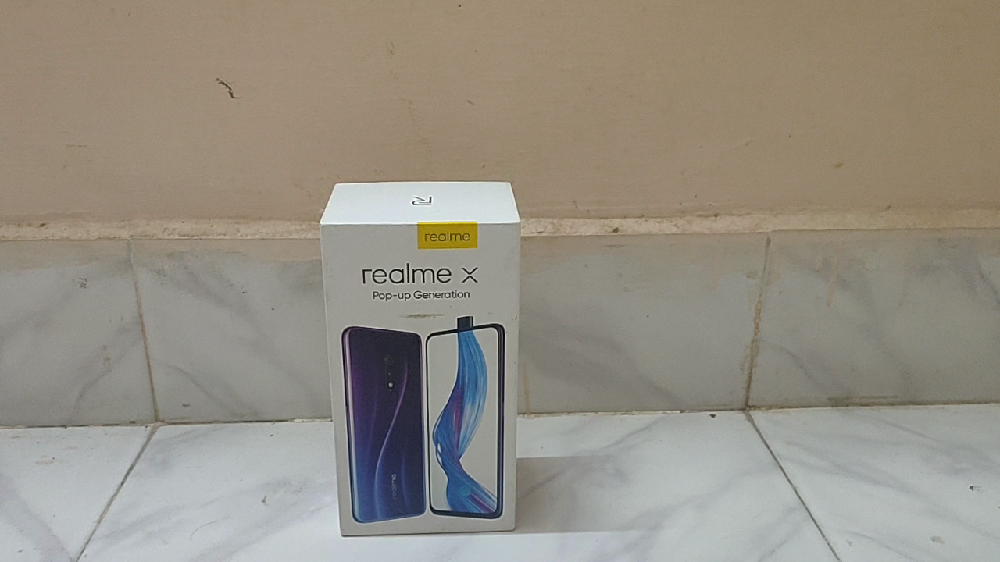

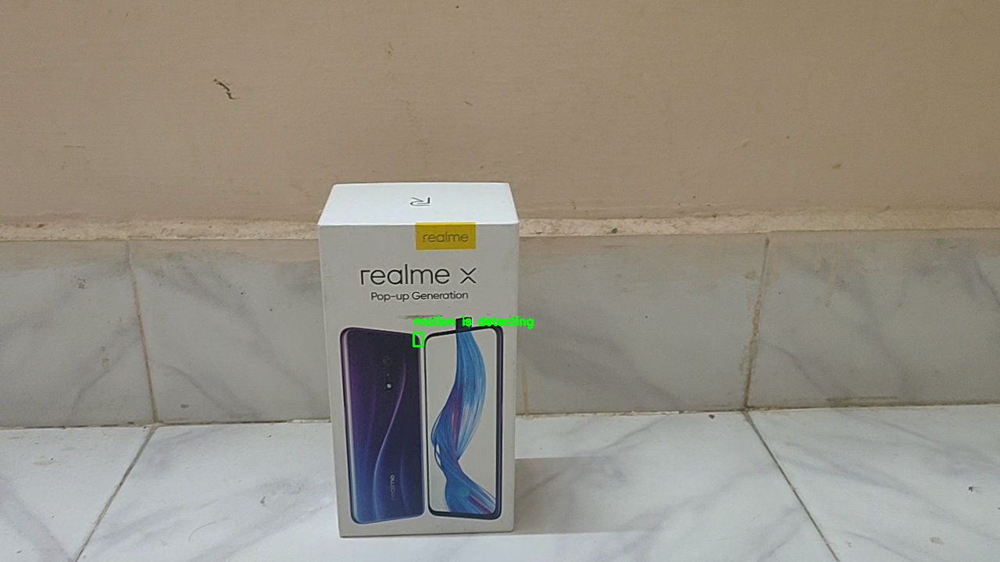

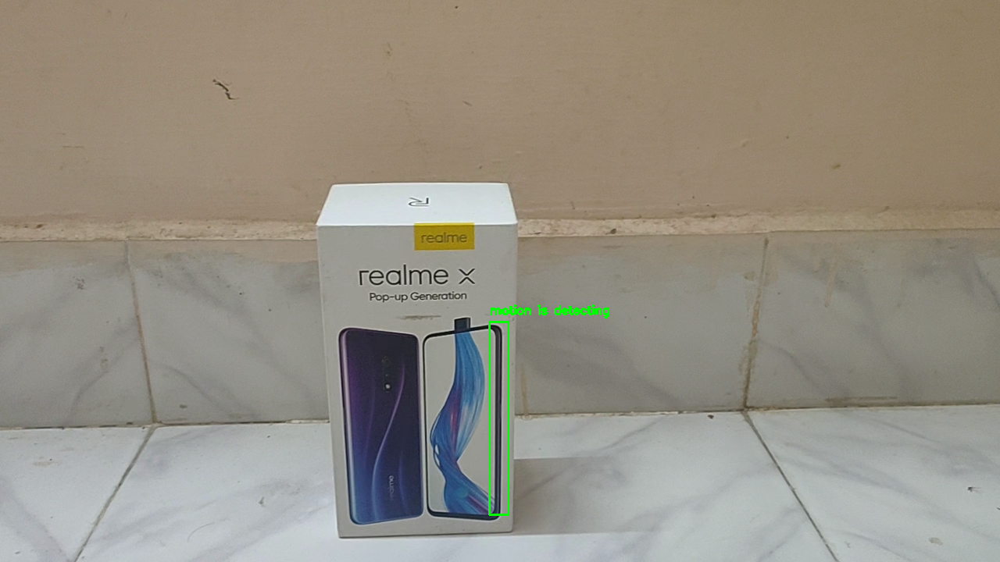

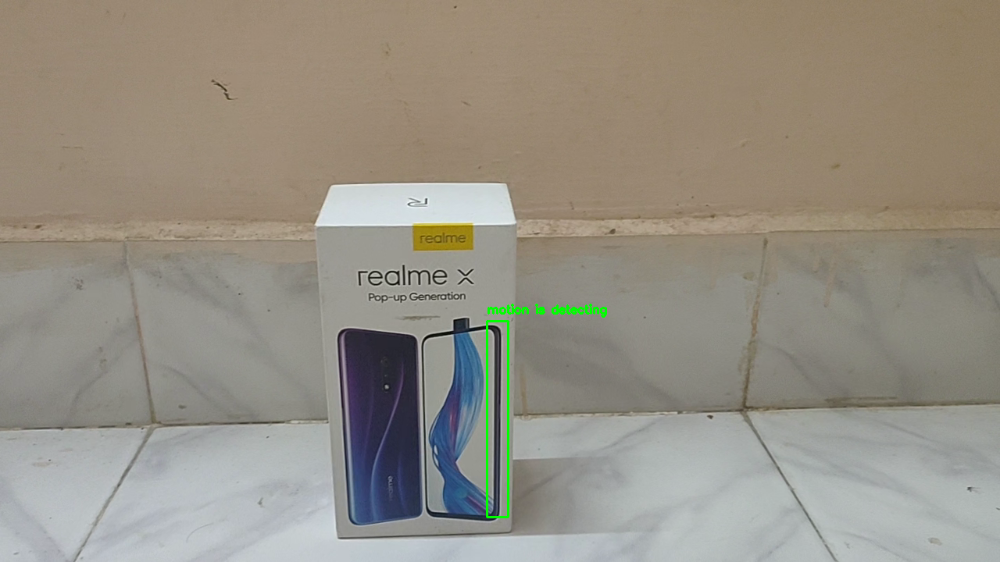

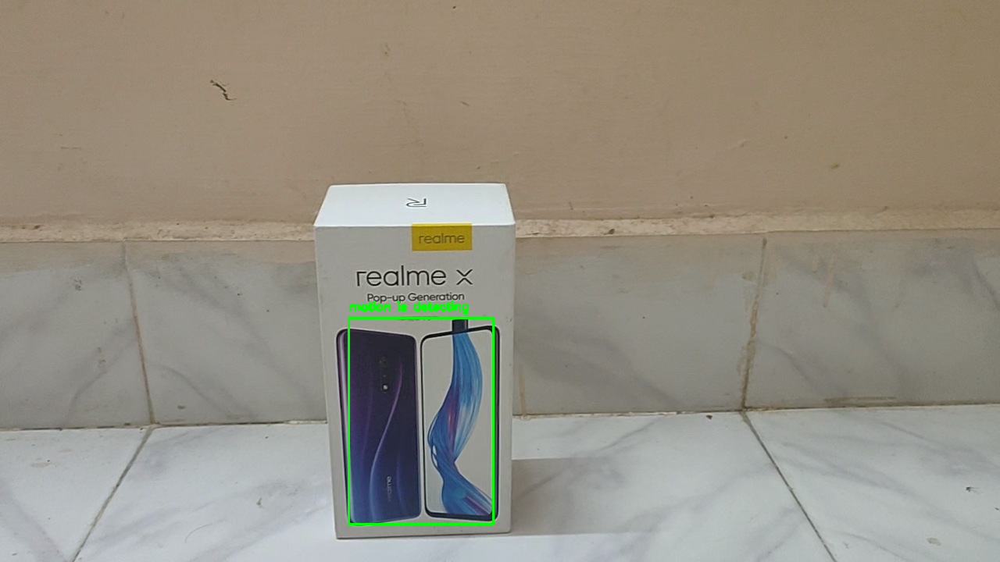

...

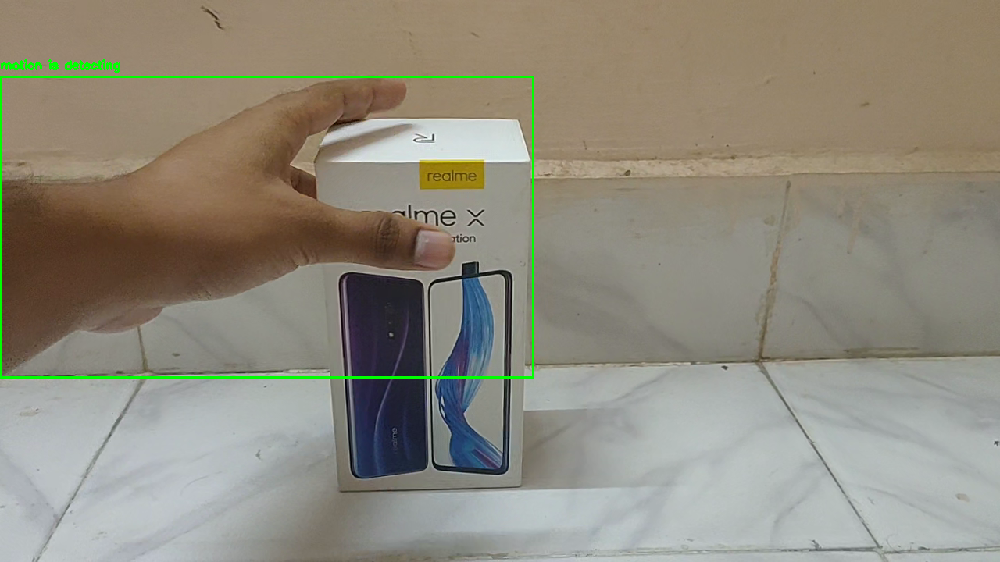

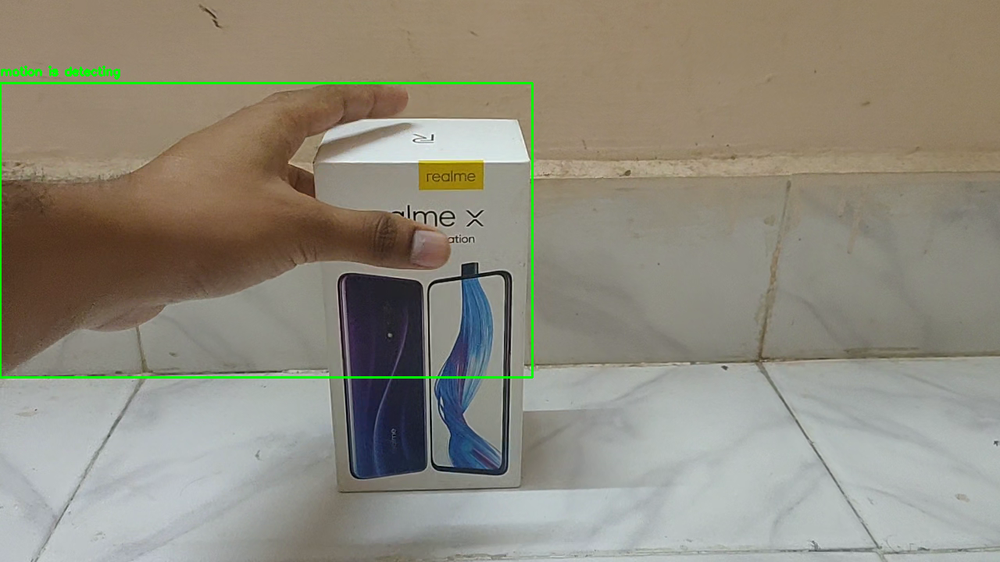

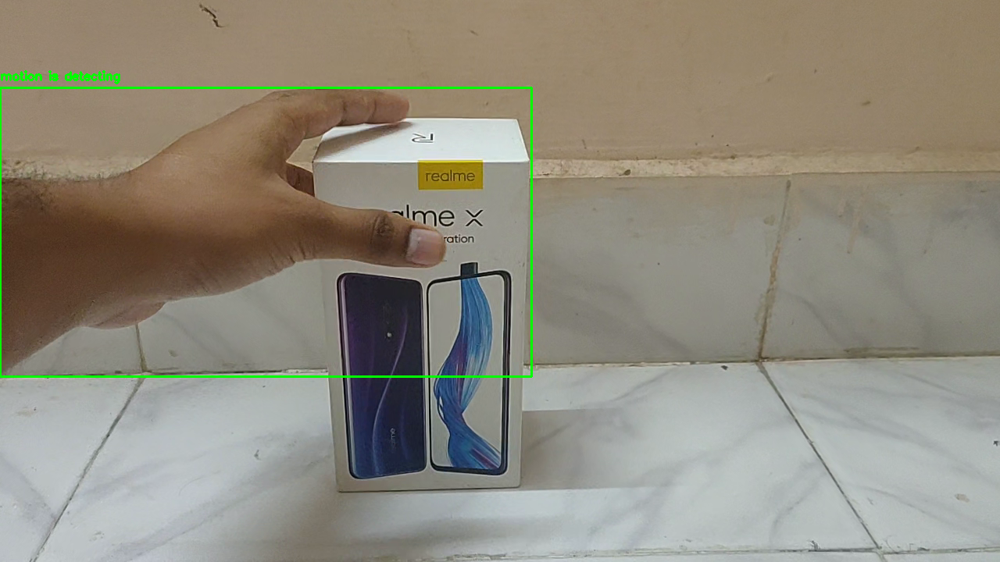

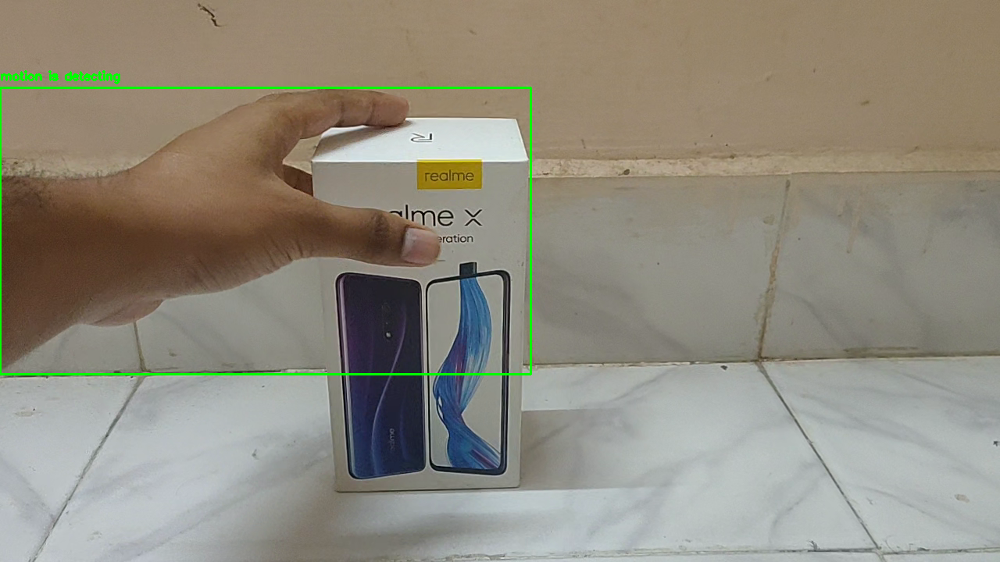

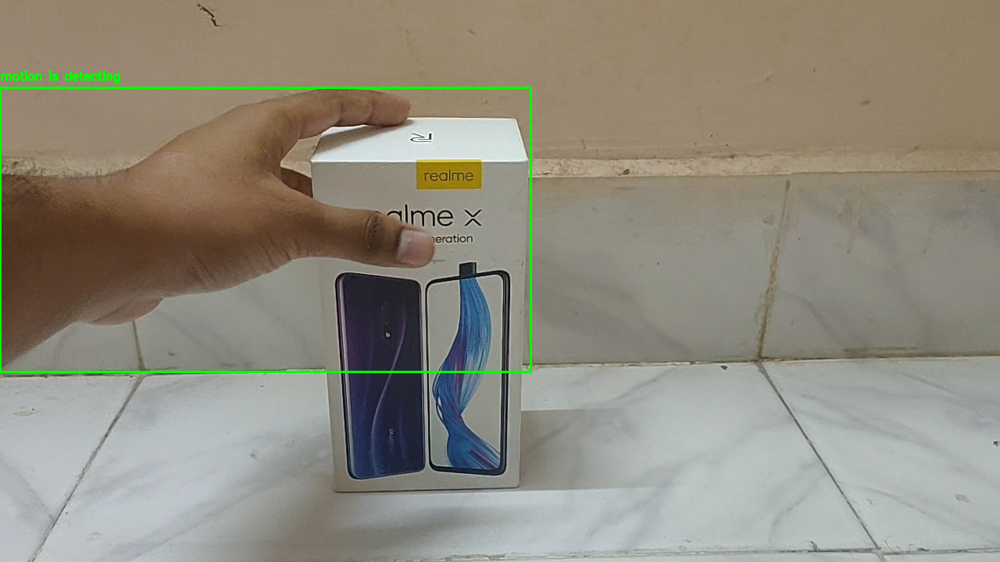

Buffered data was truncated after reaching the output size limit.

In [ ]:
while vediocap.isOpened():
    # Capture frame-by-frame
    ret, frame = vediocap.read()
    if not ret:
      break

    # Our operations on the frame come here
    
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    gray = cv2.GaussianBlur(gray,(21,21),0)

    # inittialize firstFrame which will be used as a reference
    if firstFrame is None:
        firstFrame = gray

    #obtain differnce between frames 
    frameDelta = cv2.absdiff(gray,firstFrame)

    # convert the difference into binary & dilate the result to fill in small holes
    thresh = cv2.threshold(frameDelta, 25, 255, cv2.THRESH_BINARY)[1]
    thresh = cv2.dilate(thresh, None, iterations=2)

    # find contours or continuous white blobs in the image
    #means finding white boxes 
    contours, hierarchy = cv2.findContours(thresh.copy(),cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    
    if(len(contours) > 0):
        areas = [cv2.contourArea(c) for c in contours]
        max_index = np.argmax(areas)
        cnt=contours[max_index]   

        # draw a bounding box/rectangle around the largest contour
        x,y,w,h = cv2.boundingRect(cnt)
        cv2.rectangle(frame,(x,y),(x+w,y+h),(0,255,0),2)
        area = cv2.contourArea(cnt)

        # print area to the terminal
        # print(area)
    
        # add text to the frame
        cv2.putText(frame, "motion is detecting ", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    # Display the resulting frame
    
    # cv2.imshow('frame',gray)
    out.write(frame)
    cv2_imshow(frame)
    # cv2.waitKey(1) & 0xff
    
# When everything done, release the capture
out.release()
vediocap.release()
cv2.destroyAllWindows()